In [48]:
import torch

## path to rdcost-per-block files for different models
org_imgs_path = "../experiments/blkbsdimgcomp_B8_KS3111_N768M96_v9/exp_117.045/out/list_orig_images_B8_117.045.pt"
b8_lowrate_path = "../experiments/blkbsdimgcomp_B8_KS3111_N768M96_v9/exp_117.045/out/list_rdcost_tensors_per_blk_B8_117.045.pt"
b16_lowrate_path = "../experiments/blkbsdimgcomp_B16_KS3111_N1280M192_v9/exp_117.045/out/list_rdcost_tensors_per_blk_B16_117.045.pt"
b8_highrate_path = "../experiments/blkbsdimgcomp_B8_KS3311_N1152M128_v9/exp_11704.5/out/list_rdcost_tensors_per_blk_B8_11704.5.pt"
b4_highrate_path = "../experiments/blkbsdimgcomp_B4_KS3311_N512M96_v9/exp_11704.5/out/list_rdcost_tensors_per_blk_B4_11704.5.pt"

# load the files, which give lists of tensors
orig_images_tensors = torch.load(org_imgs_path)
b8_lr_rdcost_tensors = torch.load(b8_lowrate_path)
b16_lr_rdcost_tensors = torch.load(b16_lowrate_path)
b8_hr_rdcost_tensors = torch.load(b8_highrate_path)
b4_hr_rdcost_tensors = torch.load(b4_highrate_path)

In [44]:

# print(len(b8_lr_rdcost_tensors))
# print(len(b16_lr_rdcost_tensors))
# print(b8_lr_rdcost_tensors[0].shape)
# print(b16_lr_rdcost_tensors[0].shape)
# print(b8_lr_rdcost_tensors[0][0, 0:7, 0:7])
# print(b16_lr_rdcost_tensors[0][0, 0:7, 0:7])

# print(len(orig_images_tensors))
# print(orig_images_tensors[0].shape)
# print(orig_images_tensors[0][0, :, 110:114, 120:124])

24
torch.Size([1, 3, 512, 768])
tensor([[[0.5020, 0.5020, 0.5137, 0.5137],
         [0.5216, 0.5176, 0.5373, 0.5216],
         [0.5451, 0.5451, 0.5333, 0.5451],
         [0.5647, 0.5725, 0.5725, 0.5765]],

        [[0.6078, 0.6000, 0.6078, 0.6078],
         [0.6314, 0.6235, 0.6314, 0.6314],
         [0.6510, 0.6510, 0.6431, 0.6510],
         [0.6706, 0.6784, 0.6784, 0.6863]],

        [[0.5922, 0.5843, 0.5961, 0.5961],
         [0.6118, 0.6078, 0.6157, 0.6118],
         [0.6353, 0.6353, 0.6157, 0.6235],
         [0.6549, 0.6510, 0.6510, 0.6549]]], device='cuda:0')


In [50]:
## In the 8x8 block model, average 2x2 blocks to mathc 16x16 block model
import torch.nn.functional as F

b8_lr_rdcost_tensors_16x16 = []
for b8_tensor in b8_lr_rdcost_tensors:
    pooled_tensor = F.avg_pool2d(b8_tensor, kernel_size=2, stride=2) * 4
    b8_lr_rdcost_tensors_16x16.append(pooled_tensor)

b4_hr_rdcost_tensors_8x8 = []
for b4_tensor in b4_hr_rdcost_tensors:
    pooled_tensor = F.avg_pool2d(b4_tensor, kernel_size=2, stride=2) * 4
    b4_hr_rdcost_tensors_8x8.append(pooled_tensor)

# print(b8_lr_rdcost_tensors_16x16[0][0, 0:7, 0:7])
# print(b16_lr_rdcost_tensors[0][0, 0:7, 0:7])

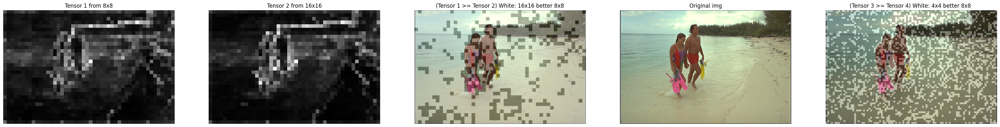

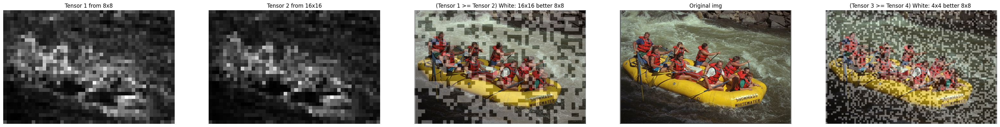

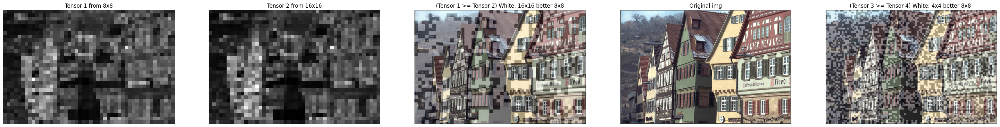

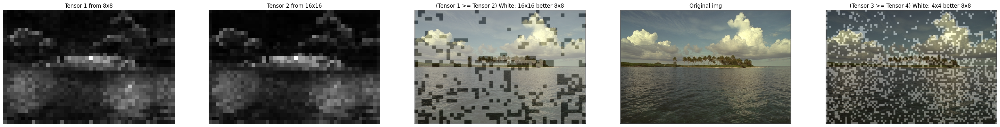

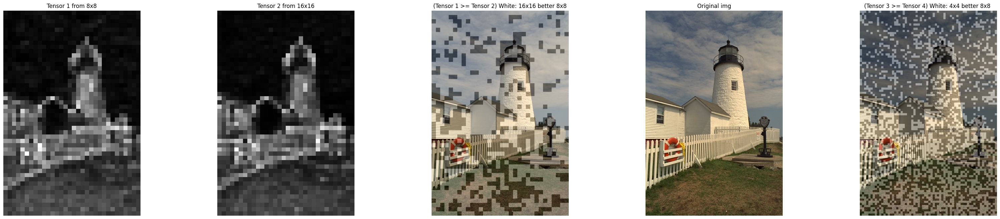

...

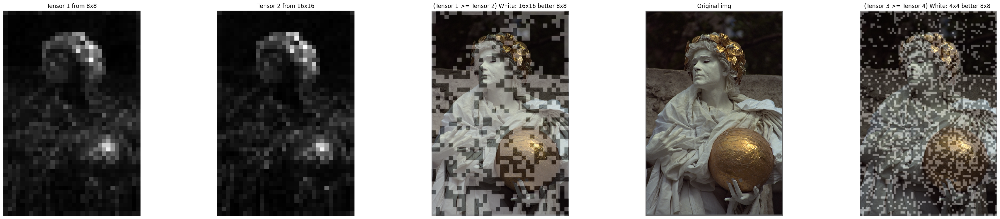

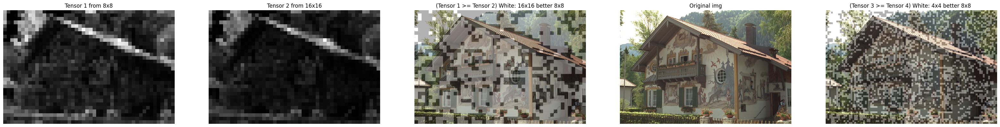

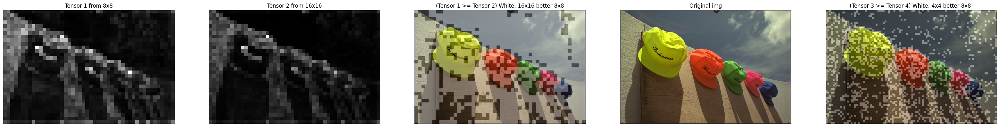

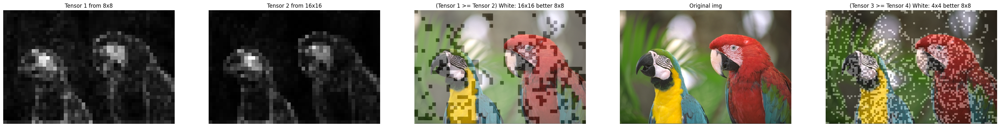

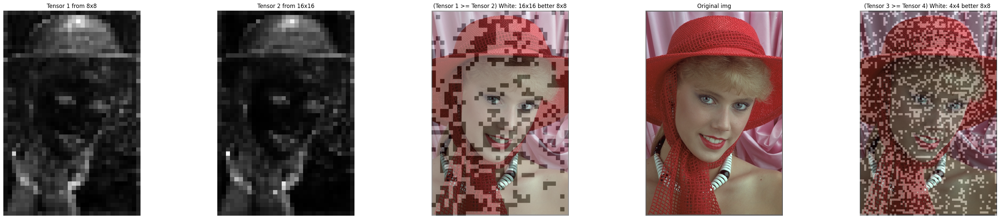

In [59]:
import matplotlib.pyplot as plt
import numpy as np

for i in range(len(b8_lr_rdcost_tensors_16x16)):
    # original images tensor
    tensorOrig = orig_images_tensors[i].squeeze(0).cpu()
    tensorOrig = tensorOrig.permute(1,2,0)

    # Remove the channel dimension by squeezing for 8x8 and 16x16
    tensor1 = b8_lr_rdcost_tensors_16x16[i].squeeze(0).cpu()
    tensor2 = b16_lr_rdcost_tensors[i].squeeze(0).cpu()
    # Create a comparison tensor: 0 where tensor1 < tensor2, 1 otherwise
    comparison_tensor12 = (tensor1 >= tensor2).float()

    # Remove the channel dimension by squeezing for 8x8 and 4x4
    tensor3 = b8_hr_rdcost_tensors[i].squeeze(0).cpu()
    tensor4 = b4_hr_rdcost_tensors_8x8[i].squeeze(0).cpu()
    # Create a comparison tensor: 0 where tensor3 < tensor4, 1 otherwise
    comparison_tensor34 = 1 - (tensor3 >= tensor4).float()

    # Normalize tensor 1 and tensor 2 to show them as pictures
    max_value1 = torch.max(tensor1)
    max_value2 = torch.max(tensor2)
    max_value = torch.max(max_value1, max_value2)
    tensor1 = tensor1 / max_value
    tensor2 = tensor2 / max_value

    # Create a figure with two subplots side by side
    fig, axs = plt.subplots(1, 5, figsize=(40, 8))

    # Plot the first tensor as a grayscale image
    axs[0].imshow(tensor1.numpy(), cmap='gray')
    axs[0].set_title('Tensor 1 from 8x8')
    axs[0].axis('off')  # Hide axes for a cleaner look

    # Plot the second tensor as a grayscale image
    axs[1].imshow(tensor2.numpy(), cmap='gray')
    axs[1].set_title('Tensor 2 from 16x16')
    axs[1].axis('off')  # Hide axes for a cleaner look

    # Plot the comparison tensor as a binary image (black and white)
    comparison_tensor12_3d = np.stack([comparison_tensor12.numpy()]*3, axis=-1)
    grayscale_array_3d_upscaled16 = np.repeat(np.repeat(comparison_tensor12_3d, 16, axis=0), 16, axis=1)
    cmp_tnsr12 = 0.3 * grayscale_array_3d_upscaled16 + 0.7 * tensorOrig.numpy()
    # axs[2].imshow(comparison_tensor12.numpy(), cmap='gray', vmin=0, vmax=1)
    axs[2].imshow(cmp_tnsr12, cmap='gray', vmin=0, vmax=1)
    axs[2].set_title('(Tensor 1 >= Tensor 2) White: 16x16 better than 8x8')
    axs[2].axis('off')  # Hide axes for a cleaner look

    # Plot original image
    axs[3].imshow(tensorOrig.numpy())
    axs[3].set_title('Original img')
    axs[3].axis('off')  # Hide axes for a cleaner look

    # Plot the comparison tensor as a binary image (black and white)
    comparison_tensor34_3d = np.stack([comparison_tensor34.numpy()]*3, axis=-1)
    grayscale_array_3d_upscaled8 = np.repeat(np.repeat(comparison_tensor34_3d, 8, axis=0), 8, axis=1)
    cmp_tnsr34 = 0.3 * grayscale_array_3d_upscaled8 + 0.7 * tensorOrig.numpy()
    # axs[4].imshow(comparison_tensor34.numpy(), cmap='gray', vmin=0, vmax=1)
    axs[4].imshow(cmp_tnsr34, cmap='gray', vmin=0, vmax=1)
    axs[4].set_title('(Tensor 3 >= Tensor 4) White: 8x8 better than 4x4 ')
    axs[4].axis('off')  # Hide axes for a cleaner look

    # Display the plots
    plt.show()